In [1]:
from pathlib import Path
import time
import glob
import json
from tqdm import tqdm

import torch
from torch import nn
from torch.utils.data import DataLoader

from sklearn.model_selection import train_test_split, KFold

from pytorch_lightning.core.lightning import LightningModule
from pytorch_lightning import Trainer
from pytorch_lightning.callbacks import ModelCheckpoint, EarlyStopping
from pytorch_lightning.loggers import TensorBoardLogger
from pytorch_lightning.utilities.model_summary import ModelSummary

import matplotlib.pyplot as plt
from matplotlib.lines import Line2D

import os
os.environ['CUDA_VISIBLE_DEVICES'] = '0'
os.chdir('../')

from utils.config_dataset import *
from utils.ClassDataset import CusDataset
from utils.ClassAE import BaseAE, LSTM_AE_ALLMED, GuidedLSTM_AE_ALLMED
from utils.ClassPredictor import LSTM_PRED_ALLMED, GuidedLSTM_PRED_ALLMED, mae_loss

RANDOMSEED=2024
torch.manual_seed(RANDOMSEED)
np.random.seed(RANDOMSEED)

import warnings
warnings.filterwarnings("ignore")

# limit CPU cores used by the script
os.environ["OMP_NUM_THREADS"] = "32" # export OMP_NUM_THREADS=1
os.environ["OPENBLAS_NUM_THREADS"] = "32" # export OPENBLAS_NUM_THREADS=1
os.environ["MKL_NUM_THREADS"] = "32" # export MKL_NUM_THREADS=1
os.environ["VECLIB_MAXIMUM_THREADS"] = "32" # export VECLIB_MAXIMUM_THREADS=1
os.environ["NUMEXPR_NUM_THREADS"] = "32" # export NUMEXPR_NUM_THREADS=1

In [2]:
archive = pickle.load(open(os.path.join(path_processed, 'training_data_allmed.p'), 'rb'))
samples = archive['samples_norm']
sample_dict = archive['sample_dict']
idx_train = archive['idx_train']
idx_test = archive['idx_test']
pid_train = archive['pid_train']
pid_test = archive['pid_test']
del archive

X_test = samples[idx_test]
dataset_test = CusDataset(X_test)
loader_test = DataLoader(dataset_test, batch_size=128, shuffle=False, num_workers=32)

In [5]:
X_rec, X_enc = pickle.load(open(os.path.join(path_processed, 'training_data_encoded_with_pretrained_GAE-2-128-0.2.p'), 'rb'))

# AE

In [82]:
# from sklearn.preprocessing import LabelEncoder
# label_encoder = LabelEncoder()

# labels = {label:[] for label in ['pharmaid', 'apache', 'sex', 'age', 'los', 'survived']}

# for idx in tqdm(sample_dict):
#     for label in ['pharmaid', 'apache', 'sex', 'age', 'los', 'survived']:
#         labels[label].append(sample_dict[idx][label])
        
# for label in ['apache', 'sex']:
#     ll = label_encoder.fit_transform(labels[label])
#     labels[label] = ll

# labels['los'] = [l.total_seconds()/3600/24 for l in labels['los']]
# labels['loglos'] = np.log(np.array(labels['los']))

100%|██████████████████████████████████████████████████████████████████████████████████████████████████| 101983/101983 [00:00<00:00, 468352.97it/s]


In [83]:
# set(labels['pharmaid']), set(labels['apache']), set(labels['sex'])

({208, 251, 426, 1000251, 1000649, 1000655, 1000657, 1000658, 1000747},
 {0, 1, 2},
 {0, 1})

In [84]:
# labels_normed = labels.copy()
# for label in ['age', 'los', 'loglos']:
#     lmax = max(labels_normed[label])
#     lmin = min(labels_normed[label])
#     lnormed = np.array(labels_normed[label])
#     lnormed = (lnormed - lmin) / (lmax - lmin)
#     labels_normed[label] = list(lnormed)
# pickle.dump(labels, open('processed-v2/training_label_allmed.p', 'wb'))
# pickle.dump(labels_normed, open('processed-v2/training_label_allmed_normed.p', 'wb'))

(array([ 4031.,  7396., 12441., 15486., 13965., 14326., 14027., 10609.,
         6901.,  2801.]),
 array([0. , 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1. ]),
 <BarContainer object of 10 artists>)

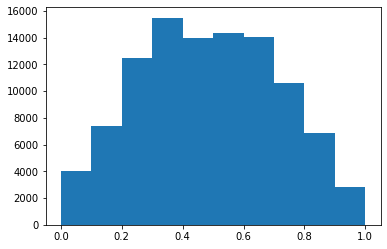

In [86]:
# plt.hist(labels_normed['loglos'])

In [5]:
labels = pickle.load(open('processed-v2/training_label_allmed.p', 'rb'))

# PCA

In [6]:
from sklearn.decomposition import KernelPCA

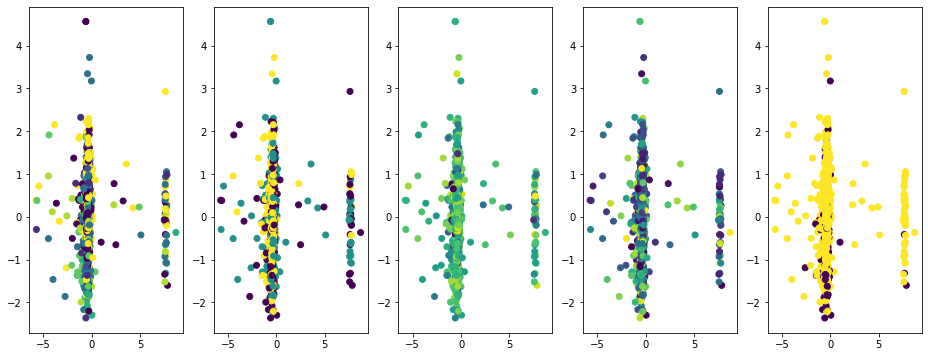

In [10]:
X = X_emb.copy()

pca = KernelPCA(n_components=5, kernel='linear', n_jobs=48)
pca.fit(X)
# plot_pca_explained_variance(pca)

idx_sub = np.random.choice(range(len(X)), 1000)
x_linear = pca.transform(X[idx_sub])

fig, ax = plt.subplots(1, 5, figsize=(16, 6))
for i, label in enumerate(labels.keys()):
    ax[i].scatter(x_linear[:, 0], x_linear[:, 1], c=labels[label][idx_sub])

# MiniSOM


In [18]:
from sklearn.decomposition import KernelPCA

from minisom import MiniSom
from matplotlib.gridspec import GridSpec
%matplotlib inline

In [3]:
# import pickle, os
# archive = pickle.load(open(os.path.join(path_processed, 'training_data_allmed.p'), 'rb'))
# idx_train = archive['idx_train']
# idx_test = archive['idx_test']
# sample_dict = archive['sample_dict']
# del archive


# X_rec, X_enc = pickle.load(open(os.path.join(path_processed, 'traning_data_classification.p'), 'rb'))

In [5]:
# X = X_enc[idx_test].reshape(len(idx_test), -1)
# pca = KernelPCA(n_components=16, kernel='linear', n_jobs=48)
# pca.fit(X)

# X_pca = pca.transform(X)
# X_pca.shape

(20183, 16)

In [35]:
X_rec, X_enc = pickle.load(open(os.path.join(path_processed, 
                                             'training_data_classification-GAE-2-128-0.2.p'), 'rb'))

In [10]:
X_full = X_enc.reshape(X_enc.shape[0], -1)
pca_full = KernelPCA(n_components=16, kernel='linear', n_jobs=48)
pca_full.fit(X_full)

X_pca_full = pca_full.transform(X_full)
X_pca_full.shape

(101983, 16)

In [11]:
pickle.dump(X_pca_full, open(os.path.join(path_processed, 'ae_encoded_data_pca-GAE-2-128-02.p'), 'wb'))

In [36]:
len(X_rec)

101983

In [15]:
files = [
#     'training_data_classification-AE-2-128-0.2.p',
#     'training_data_classification-GAE-2-128-0.2.p',
    'training_data_classification-AE-3-128-0.1.p',
    'training_data_classification-AE-2-128-0.1.p',
    'training_data_classification-AE-2-256-0.1.p',
    
    'training_data_classification-GAE-2-128-0.1.p',
    'training_data_classification-GAE-2-256-0.1.p',
#     'training_data_classification-GAE-3-128-0.1.p',
]


for file in files:

    X_rec, X_enc = pickle.load(open(os.path.join(path_processed, file), 'rb'))
    X_full = X_enc.reshape(X_enc.shape[0], -1)
    pca_full = KernelPCA(n_components=16, kernel='linear', n_jobs=48)
    pca_full.fit(X_full)

    X_pca_full = pca_full.transform(X_full)
#     X_pca_full.shape
    save_file_name = file.replace('training_data_classification', 'ae_encoded_data_pca')
    pickle.dump(X_pca_full, open(os.path.join(path_processed, save_file_name), 'wb'))

In [14]:
X_pca_full = pickle.load(open(os.path.join(path_processed, 
                                           'ae_encoded_data_pca-GAE-2-128-02.p'), 'rb'))

In [16]:
X_pca = X_pca_full[idx_test]
X_pca.shape

(20183, 16)

In [6]:
data = X_enc.reshape(X_enc.shape[0], -1)

In [7]:
print(f'num_feat: {data.shape[1]}')
print(f'SOM size: {np.sqrt(5 * np.sqrt(data.shape[0]))}')

num_feat: 640
SOM size: 39.959215008056894


In [19]:
som = MiniSom(20, 20, 16, sigma=2., learning_rate=0.5, 
              neighborhood_function='bubble', random_seed=10)
print('Initializing weights...')
# som.pca_weights_init(X_pca)
som.random_weights_init(X_pca)
print("Training...")
som.train(X_pca, 30,
          random_order=True, verbose=True, use_epochs=True)  # random training
print("\n...ready!")

Initializing weights...
Training...


 [   1654 / 605490 ]   0% - 0:02:24 left 

 [   2292 / 605490 ]   0% - 0:02:37 left 

 [   2783 / 605490 ]   0% - 0:02:53 left 

 [   3590 / 605490 ]   1% - 0:02:47 left 

 [   4126 / 605490 ]   1% - 0:02:54 left 

 [   4817 / 605490 ]   1% - 0:02:54 left 

 [   5453 / 605490 ]   1% - 0:02:56 left 

 [   6196 / 605490 ]   1% - 0:02:55 left 

 [   7078 / 605490 ]   1% - 0:02:50 left 

 [   7845 / 605490 ]   1% - 0:02:48 left 

 [   8484 / 605490 ]   1% - 0:02:49 left 

 [   9176 / 605490 ]   2% - 0:02:51 left 

 [   9745 / 605490 ]   2% - 0:02:53 left 

 [  10443 / 605490 ]   2% - 0:02:53 left 

 [  11267 / 605490 ]   2% - 0:02:51 left 

 [  12146 / 605490 ]   2% - 0:02:48 left 

 [  12877 / 605490 ]   2% - 0:02:48 left 

 [  13483 / 605490 ]   2% - 0:02:49 left 

 [  14319 / 605490 ]   2% - 0:02:47 left 

 [  14982 / 605490 ]   2% - 0:02:47 left 

 [  15732 / 605490 ]   3% - 0:02:47 left 

 [  16500 / 605490 ]   3% - 0:02:46 left 

 [  17258 / 605490 ]   3% - 0:02:45 left 

 [  18084 / 605490 ]   3% - 0:02:44 left 

 [  18935 / 605490 ]   3% - 0:02:43 left 

 [  19718 / 605490 ]   3% - 0:02:42 left 

 [  20575 / 605490 ]   3% - 0:02:41 left 

 [  21384 / 605490 ]   4% - 0:02:40 left 

 [  22232 / 605490 ]   4% - 0:02:39 left 

 [  23051 / 605490 ]   4% - 0:02:38 left 

 [  23904 / 605490 ]   4% - 0:02:37 left 

 [  24760 / 605490 ]   4% - 0:02:36 left 

 [  25609 / 605490 ]   4% - 0:02:35 left 

 [  26471 / 605490 ]   4% - 0:02:34 left 

 [  27337 / 605490 ]   5% - 0:02:34 left 

 [  28173 / 605490 ]   5% - 0:02:33 left 

 [  29047 / 605490 ]   5% - 0:02:32 left 

 [  29916 / 605490 ]   5% - 0:02:31 left 

 [  30785 / 605490 ]   5% - 0:02:30 left 

 [  31632 / 605490 ]   5% - 0:02:30 left 

 [  32459 / 605490 ]   5% - 0:02:29 left 

 [  33325 / 605490 ]   6% - 0:02:29 left 

 [  34130 / 605490 ]   6% - 0:02:28 left 

 [  34965 / 605490 ]   6% - 0:02:28 left 

 [  35650 / 605490 ]   6% - 0:02:28 left 

 [  36430 / 605490 ]   6% - 0:02:28 left 

 [  37168 / 605490 ]   6% - 0:02:28 left 

 [  37896 / 605490 ]   6% - 0:02:28 left 

 [  38634 / 605490 ]   6% - 0:02:28 left 

 [  39377 / 605490 ]   7% - 0:02:28 left 

 [  40200 / 605490 ]   7% - 0:02:27 left 

 [  41068 / 605490 ]   7% - 0:02:27 left 

 [  41918 / 605490 ]   7% - 0:02:26 left 

 [  42677 / 605490 ]   7% - 0:02:26 left 

 [  43512 / 605490 ]   7% - 0:02:26 left 

 [  43922 / 605490 ]   7% - 0:02:27 left 

 [  44504 / 605490 ]   7% - 0:02:27 left 

 [  45006 / 605490 ]   7% - 0:02:28 left 

 [  45590 / 605490 ]   8% - 0:02:28 left 

 [  45909 / 605490 ]   8% - 0:02:30 left 

 [  46557 / 605490 ]   8% - 0:02:30 left 

 [  47096 / 605490 ]   8% - 0:02:30 left 

 [  47644 / 605490 ]   8% - 0:02:31 left 

 [  48398 / 605490 ]   8% - 0:02:31 left 

 [  49261 / 605490 ]   8% - 0:02:30 left 

 [  49643 / 605490 ]   8% - 0:02:31 left 

 [  50460 / 605490 ]   8% - 0:02:31 left 

 [  51307 / 605490 ]   8% - 0:02:30 left 

 [  52156 / 605490 ]   9% - 0:02:30 left 

 [  52945 / 605490 ]   9% - 0:02:29 left 

 [  53646 / 605490 ]   9% - 0:02:29 left 

 [  54046 / 605490 ]   9% - 0:02:30 left 

 [  54591 / 605490 ]   9% - 0:02:31 left 

 [  55162 / 605490 ]   9% - 0:02:31 left 

 [  55787 / 605490 ]   9% - 0:02:31 left 

 [  56296 / 605490 ]   9% - 0:02:31 left 

 [  56640 / 605490 ]   9% - 0:02:32 left 

 [  57267 / 605490 ]   9% - 0:02:32 left 

 [  58084 / 605490 ]  10% - 0:02:32 left 

 [  58932 / 605490 ]  10% - 0:02:31 left 

 [  59357 / 605490 ]  10% - 0:02:32 left 

 [  59756 / 605490 ]  10% - 0:02:33 left 

 [  60598 / 605490 ]  10% - 0:02:32 left 

 [  61448 / 605490 ]  10% - 0:02:32 left 

 [  62179 / 605490 ]  10% - 0:02:31 left 

 [  62850 / 605490 ]  10% - 0:02:31 left 

 [  63600 / 605490 ]  11% - 0:02:31 left 

 [  64375 / 605490 ]  11% - 0:02:31 left 

 [  65094 / 605490 ]  11% - 0:02:31 left 

 [  65886 / 605490 ]  11% - 0:02:30 left 

 [  66756 / 605490 ]  11% - 0:02:30 left 

 [  67590 / 605490 ]  11% - 0:02:29 left 

 [  68460 / 605490 ]  11% - 0:02:29 left 

 [  69289 / 605490 ]  11% - 0:02:28 left 

 [  70128 / 605490 ]  12% - 0:02:28 left 

 [  70708 / 605490 ]  12% - 0:02:28 left 

 [  71471 / 605490 ]  12% - 0:02:28 left 

 [  72313 / 605490 ]  12% - 0:02:27 left 

 [  73110 / 605490 ]  12% - 0:02:27 left 

 [  73920 / 605490 ]  12% - 0:02:26 left 

 [  74718 / 605490 ]  12% - 0:02:26 left 

 [  75542 / 605490 ]  12% - 0:02:26 left 

 [  76387 / 605490 ]  13% - 0:02:25 left 

 [  77253 / 605490 ]  13% - 0:02:25 left 

 [  78093 / 605490 ]  13% - 0:02:24 left 

 [  78744 / 605490 ]  13% - 0:02:24 left 

 [  79358 / 605490 ]  13% - 0:02:24 left 

 [  80143 / 605490 ]  13% - 0:02:24 left 

 [  80994 / 605490 ]  13% - 0:02:23 left 

 [  81748 / 605490 ]  14% - 0:02:23 left 

 [  82536 / 605490 ]  14% - 0:02:23 left 

 [  83252 / 605490 ]  14% - 0:02:23 left 

 [  83841 / 605490 ]  14% - 0:02:23 left 

 [  84455 / 605490 ]  14% - 0:02:23 left 

 [  85101 / 605490 ]  14% - 0:02:23 left 

 [  85843 / 605490 ]  14% - 0:02:23 left 

 [  86608 / 605490 ]  14% - 0:02:22 left 

 [  87159 / 605490 ]  14% - 0:02:23 left 

 [  87896 / 605490 ]  15% - 0:02:22 left 

 [  88588 / 605490 ]  15% - 0:02:22 left 

 [  89236 / 605490 ]  15% - 0:02:22 left 

 [  89888 / 605490 ]  15% - 0:02:22 left 

 [  90472 / 605490 ]  15% - 0:02:22 left 

 [  91261 / 605490 ]  15% - 0:02:22 left 

 [  92051 / 605490 ]  15% - 0:02:22 left 

 [  92933 / 605490 ]  15% - 0:02:21 left 

 [  93812 / 605490 ]  15% - 0:02:21 left 

 [  94519 / 605490 ]  16% - 0:02:21 left 

 [  95143 / 605490 ]  16% - 0:02:21 left 

 [  95961 / 605490 ]  16% - 0:02:20 left 

 [  96554 / 605490 ]  16% - 0:02:20 left 

 [  97347 / 605490 ]  16% - 0:02:20 left 

 [  97927 / 605490 ]  16% - 0:02:20 left 

 [  98566 / 605490 ]  16% - 0:02:20 left 

 [  99269 / 605490 ]  16% - 0:02:20 left 

 [  99775 / 605490 ]  16% - 0:02:20 left 

 [ 100425 / 605490 ]  17% - 0:02:20 left 

 [ 101000 / 605490 ]  17% - 0:02:20 left 

 [ 101620 / 605490 ]  17% - 0:02:20 left 

 [ 102316 / 605490 ]  17% - 0:02:20 left 

 [ 102927 / 605490 ]  17% - 0:02:20 left 

 [ 103712 / 605490 ]  17% - 0:02:19 left 

 [ 104500 / 605490 ]  17% - 0:02:19 left 

 [ 105147 / 605490 ]  17% - 0:02:19 left 

 [ 105907 / 605490 ]  17% - 0:02:19 left 

 [ 106734 / 605490 ]  18% - 0:02:19 left 

 [ 107388 / 605490 ]  18% - 0:02:18 left 

 [ 108116 / 605490 ]  18% - 0:02:18 left 

 [ 108945 / 605490 ]  18% - 0:02:18 left 

 [ 109628 / 605490 ]  18% - 0:02:18 left 

 [ 110174 / 605490 ]  18% - 0:02:18 left 

 [ 110956 / 605490 ]  18% - 0:02:18 left 

 [ 111655 / 605490 ]  18% - 0:02:17 left 

 [ 112301 / 605490 ]  19% - 0:02:17 left 

 [ 112728 / 605490 ]  19% - 0:02:18 left 

 [ 113397 / 605490 ]  19% - 0:02:17 left 

 [ 114154 / 605490 ]  19% - 0:02:17 left 

 [ 114944 / 605490 ]  19% - 0:02:17 left 

 [ 115806 / 605490 ]  19% - 0:02:16 left 

 [ 116626 / 605490 ]  19% - 0:02:16 left 

 [ 117500 / 605490 ]  19% - 0:02:16 left 

 [ 118364 / 605490 ]  20% - 0:02:15 left 

 [ 119204 / 605490 ]  20% - 0:02:15 left 

 [ 120016 / 605490 ]  20% - 0:02:15 left 

 [ 120843 / 605490 ]  20% - 0:02:14 left 

 [ 121689 / 605490 ]  20% - 0:02:14 left 

 [ 122557 / 605490 ]  20% - 0:02:13 left 

 [ 123343 / 605490 ]  20% - 0:02:13 left 

 [ 124185 / 605490 ]  21% - 0:02:13 left 

 [ 125038 / 605490 ]  21% - 0:02:12 left 

 [ 125881 / 605490 ]  21% - 0:02:12 left 

 [ 126526 / 605490 ]  21% - 0:02:12 left 

 [ 127393 / 605490 ]  21% - 0:02:12 left 

 [ 128229 / 605490 ]  21% - 0:02:11 left 

 [ 129059 / 605490 ]  21% - 0:02:11 left 

 [ 129897 / 605490 ]  21% - 0:02:11 left 

 [ 130724 / 605490 ]  22% - 0:02:10 left 

 [ 131535 / 605490 ]  22% - 0:02:10 left 

 [ 132304 / 605490 ]  22% - 0:02:10 left 

 [ 133170 / 605490 ]  22% - 0:02:09 left 

 [ 133986 / 605490 ]  22% - 0:02:09 left 

 [ 134810 / 605490 ]  22% - 0:02:09 left 

 [ 135674 / 605490 ]  22% - 0:02:08 left 

 [ 136509 / 605490 ]  23% - 0:02:08 left 

 [ 137390 / 605490 ]  23% - 0:02:08 left 

 [ 138244 / 605490 ]  23% - 0:02:07 left 

 [ 139070 / 605490 ]  23% - 0:02:07 left 

 [ 139934 / 605490 ]  23% - 0:02:07 left 

 [ 140782 / 605490 ]  23% - 0:02:06 left 

 [ 141604 / 605490 ]  23% - 0:02:06 left 

 [ 142434 / 605490 ]  24% - 0:02:06 left 

 [ 143013 / 605490 ]  24% - 0:02:06 left 

 [ 143870 / 605490 ]  24% - 0:02:05 left 

 [ 144724 / 605490 ]  24% - 0:02:05 left 

 [ 145438 / 605490 ]  24% - 0:02:05 left 

 [ 146222 / 605490 ]  24% - 0:02:05 left 

 [ 147088 / 605490 ]  24% - 0:02:04 left 

 [ 147864 / 605490 ]  24% - 0:02:04 left 

 [ 148580 / 605490 ]  25% - 0:02:04 left 

 [ 149290 / 605490 ]  25% - 0:02:04 left 

 [ 149867 / 605490 ]  25% - 0:02:04 left 

 [ 150267 / 605490 ]  25% - 0:02:04 left 

 [ 150924 / 605490 ]  25% - 0:02:04 left 

 [ 151376 / 605490 ]  25% - 0:02:04 left 

 [ 152235 / 605490 ]  25% - 0:02:04 left 

 [ 153069 / 605490 ]  25% - 0:02:03 left 

 [ 153843 / 605490 ]  25% - 0:02:03 left 

 [ 154615 / 605490 ]  26% - 0:02:03 left 

 [ 155254 / 605490 ]  26% - 0:02:03 left 

 [ 155874 / 605490 ]  26% - 0:02:03 left 

 [ 156500 / 605490 ]  26% - 0:02:02 left 

 [ 157061 / 605490 ]  26% - 0:02:02 left 

 [ 157531 / 605490 ]  26% - 0:02:03 left 

 [ 158268 / 605490 ]  26% - 0:02:02 left 

 [ 158751 / 605490 ]  26% - 0:02:02 left 

 [ 159517 / 605490 ]  26% - 0:02:02 left 

 [ 159924 / 605490 ]  26% - 0:02:02 left 

 [ 160341 / 605490 ]  26% - 0:02:02 left 

 [ 160702 / 605490 ]  27% - 0:02:03 left 

 [ 161247 / 605490 ]  27% - 0:02:03 left 

 [ 161650 / 605490 ]  27% - 0:02:03 left 

 [ 162111 / 605490 ]  27% - 0:02:03 left 

 [ 162596 / 605490 ]  27% - 0:02:03 left 

 [ 163454 / 605490 ]  27% - 0:02:03 left 

 [ 164313 / 605490 ]  27% - 0:02:02 left 

 [ 165161 / 605490 ]  27% - 0:02:02 left 

 [ 166001 / 605490 ]  27% - 0:02:02 left 

 [ 166845 / 605490 ]  28% - 0:02:01 left 

 [ 167700 / 605490 ]  28% - 0:02:01 left 

 [ 168528 / 605490 ]  28% - 0:02:01 left 

 [ 169376 / 605490 ]  28% - 0:02:00 left 

 [ 170218 / 605490 ]  28% - 0:02:00 left 

 [ 170756 / 605490 ]  28% - 0:02:00 left 

 [ 171605 / 605490 ]  28% - 0:02:00 left 

 [ 172399 / 605490 ]  28% - 0:01:59 left 

 [ 173244 / 605490 ]  29% - 0:01:59 left 

 [ 174003 / 605490 ]  29% - 0:01:59 left 

 [ 174765 / 605490 ]  29% - 0:01:59 left 

 [ 175531 / 605490 ]  29% - 0:01:58 left 

 [ 176346 / 605490 ]  29% - 0:01:58 left 

 [ 177004 / 605490 ]  29% - 0:01:58 left 

 [ 177510 / 605490 ]  29% - 0:01:58 left 

 [ 178242 / 605490 ]  29% - 0:01:58 left 

 [ 178858 / 605490 ]  30% - 0:01:58 left 

 [ 179516 / 605490 ]  30% - 0:01:57 left 

 [ 180175 / 605490 ]  30% - 0:01:57 left 

 [ 180820 / 605490 ]  30% - 0:01:57 left 

 [ 181445 / 605490 ]  30% - 0:01:57 left 

 [ 182262 / 605490 ]  30% - 0:01:57 left 

 [ 183015 / 605490 ]  30% - 0:01:57 left 

 [ 183618 / 605490 ]  30% - 0:01:57 left 

 [ 184149 / 605490 ]  30% - 0:01:56 left 

 [ 184841 / 605490 ]  31% - 0:01:56 left 

 [ 185623 / 605490 ]  31% - 0:01:56 left 

 [ 186179 / 605490 ]  31% - 0:01:56 left 

 [ 186808 / 605490 ]  31% - 0:01:56 left 

 [ 187389 / 605490 ]  31% - 0:01:56 left 

 [ 188228 / 605490 ]  31% - 0:01:56 left 

 [ 189005 / 605490 ]  31% - 0:01:55 left 

 [ 189837 / 605490 ]  31% - 0:01:55 left 

 [ 190662 / 605490 ]  31% - 0:01:55 left 

 [ 191418 / 605490 ]  32% - 0:01:54 left 

 [ 192161 / 605490 ]  32% - 0:01:54 left 

 [ 192891 / 605490 ]  32% - 0:01:54 left 

 [ 193563 / 605490 ]  32% - 0:01:54 left 

 [ 194272 / 605490 ]  32% - 0:01:54 left 

 [ 194817 / 605490 ]  32% - 0:01:54 left 

 [ 195461 / 605490 ]  32% - 0:01:54 left 

 [ 196102 / 605490 ]  32% - 0:01:53 left 

 [ 196645 / 605490 ]  32% - 0:01:53 left 

 [ 197223 / 605490 ]  33% - 0:01:53 left 

 [ 197788 / 605490 ]  33% - 0:01:53 left 

 [ 198573 / 605490 ]  33% - 0:01:53 left 

 [ 199330 / 605490 ]  33% - 0:01:53 left 

 [ 200050 / 605490 ]  33% - 0:01:53 left 

 [ 200903 / 605490 ]  33% - 0:01:52 left 

 [ 201449 / 605490 ]  33% - 0:01:52 left 

 [ 202091 / 605490 ]  33% - 0:01:52 left 

 [ 202795 / 605490 ]  33% - 0:01:52 left 

 [ 203415 / 605490 ]  34% - 0:01:52 left 

 [ 204037 / 605490 ]  34% - 0:01:52 left 

 [ 204801 / 605490 ]  34% - 0:01:51 left 

 [ 205439 / 605490 ]  34% - 0:01:51 left 

 [ 206114 / 605490 ]  34% - 0:01:51 left 

 [ 206655 / 605490 ]  34% - 0:01:51 left 

 [ 207367 / 605490 ]  34% - 0:01:51 left 

 [ 208104 / 605490 ]  34% - 0:01:51 left 

 [ 208756 / 605490 ]  34% - 0:01:51 left 

 [ 209258 / 605490 ]  35% - 0:01:51 left 

 [ 209738 / 605490 ]  35% - 0:01:51 left 

 [ 210234 / 605490 ]  35% - 0:01:50 left 

 [ 211013 / 605490 ]  35% - 0:01:50 left 

 [ 211884 / 605490 ]  35% - 0:01:50 left 

 [ 212696 / 605490 ]  35% - 0:01:50 left 

 [ 213545 / 605490 ]  35% - 0:01:49 left 

 [ 214410 / 605490 ]  35% - 0:01:49 left 

 [ 215216 / 605490 ]  36% - 0:01:49 left 

 [ 216076 / 605490 ]  36% - 0:01:48 left 

 [ 216924 / 605490 ]  36% - 0:01:48 left 

 [ 217773 / 605490 ]  36% - 0:01:48 left 

 [ 218590 / 605490 ]  36% - 0:01:48 left 

 [ 219424 / 605490 ]  36% - 0:01:47 left 

 [ 220272 / 605490 ]  36% - 0:01:47 left 

 [ 221105 / 605490 ]  37% - 0:01:47 left 

 [ 221951 / 605490 ]  37% - 0:01:46 left 

 [ 222792 / 605490 ]  37% - 0:01:46 left 

 [ 223623 / 605490 ]  37% - 0:01:46 left 

 [ 224431 / 605490 ]  37% - 0:01:46 left 

 [ 225237 / 605490 ]  37% - 0:01:45 left 

 [ 225965 / 605490 ]  37% - 0:01:45 left 

 [ 226758 / 605490 ]  37% - 0:01:45 left 

 [ 227558 / 605490 ]  38% - 0:01:45 left 

 [ 228280 / 605490 ]  38% - 0:01:44 left 

 [ 229121 / 605490 ]  38% - 0:01:44 left 

 [ 230002 / 605490 ]  38% - 0:01:44 left 

 [ 230824 / 605490 ]  38% - 0:01:44 left 

 [ 231663 / 605490 ]  38% - 0:01:43 left 

 [ 232514 / 605490 ]  38% - 0:01:43 left 

 [ 233359 / 605490 ]  39% - 0:01:43 left 

 [ 234202 / 605490 ]  39% - 0:01:42 left 

 [ 235033 / 605490 ]  39% - 0:01:42 left 

 [ 235612 / 605490 ]  39% - 0:01:42 left 

 [ 236238 / 605490 ]  39% - 0:01:42 left 

 [ 237046 / 605490 ]  39% - 0:01:42 left 

 [ 237742 / 605490 ]  39% - 0:01:41 left 

 [ 238137 / 605490 ]  39% - 0:01:41 left 

 [ 238517 / 605490 ]  39% - 0:01:42 left 

 [ 239007 / 605490 ]  39% - 0:01:42 left 

 [ 239517 / 605490 ]  40% - 0:01:41 left 

 [ 240220 / 605490 ]  40% - 0:01:41 left 

 [ 240776 / 605490 ]  40% - 0:01:41 left 

 [ 241396 / 605490 ]  40% - 0:01:41 left 

 [ 242254 / 605490 ]  40% - 0:01:41 left 

 [ 243125 / 605490 ]  40% - 0:01:40 left 

 [ 243988 / 605490 ]  40% - 0:01:40 left 

 [ 244845 / 605490 ]  40% - 0:01:40 left 

 [ 245311 / 605490 ]  41% - 0:01:40 left 

 [ 246078 / 605490 ]  41% - 0:01:40 left 

 [ 246843 / 605490 ]  41% - 0:01:39 left 

 [ 247671 / 605490 ]  41% - 0:01:39 left 

 [ 248490 / 605490 ]  41% - 0:01:39 left 

 [ 249312 / 605490 ]  41% - 0:01:39 left 

 [ 250014 / 605490 ]  41% - 0:01:38 left 

 [ 250780 / 605490 ]  41% - 0:01:38 left 

 [ 251454 / 605490 ]  42% - 0:01:38 left 

 [ 252360 / 605490 ]  42% - 0:01:38 left 

 [ 253241 / 605490 ]  42% - 0:01:37 left 

 [ 253754 / 605490 ]  42% - 0:01:37 left 

 [ 254580 / 605490 ]  42% - 0:01:37 left 

 [ 254941 / 605490 ]  42% - 0:01:37 left 

 [ 255588 / 605490 ]  42% - 0:01:37 left 

 [ 256188 / 605490 ]  42% - 0:01:37 left 

 [ 257020 / 605490 ]  42% - 0:01:37 left 

 [ 257653 / 605490 ]  43% - 0:01:36 left 

 [ 258424 / 605490 ]  43% - 0:01:36 left 

 [ 259080 / 605490 ]  43% - 0:01:36 left 

 [ 259839 / 605490 ]  43% - 0:01:36 left 

 [ 260535 / 605490 ]  43% - 0:01:36 left 

 [ 261241 / 605490 ]  43% - 0:01:35 left 

 [ 262027 / 605490 ]  43% - 0:01:35 left 

 [ 262791 / 605490 ]  43% - 0:01:35 left 

 [ 263498 / 605490 ]  44% - 0:01:35 left 

 [ 264268 / 605490 ]  44% - 0:01:35 left 

 [ 265047 / 605490 ]  44% - 0:01:34 left 

 [ 265808 / 605490 ]  44% - 0:01:34 left 

 [ 266389 / 605490 ]  44% - 0:01:34 left 

 [ 267185 / 605490 ]  44% - 0:01:34 left 

 [ 267992 / 605490 ]  44% - 0:01:33 left 

 [ 268799 / 605490 ]  44% - 0:01:33 left 

 [ 269618 / 605490 ]  45% - 0:01:33 left 

 [ 270441 / 605490 ]  45% - 0:01:33 left 

 [ 271253 / 605490 ]  45% - 0:01:32 left 

 [ 272049 / 605490 ]  45% - 0:01:32 left 

 [ 272581 / 605490 ]  45% - 0:01:32 left 

 [ 273372 / 605490 ]  45% - 0:01:32 left 

 [ 274117 / 605490 ]  45% - 0:01:32 left 

 [ 274907 / 605490 ]  45% - 0:01:31 left 

 [ 275670 / 605490 ]  46% - 0:01:31 left 

 [ 276328 / 605490 ]  46% - 0:01:31 left 

 [ 277090 / 605490 ]  46% - 0:01:31 left 

 [ 277868 / 605490 ]  46% - 0:01:31 left 

 [ 278531 / 605490 ]  46% - 0:01:30 left 

 [ 279400 / 605490 ]  46% - 0:01:30 left 

 [ 280258 / 605490 ]  46% - 0:01:30 left 

 [ 281020 / 605490 ]  46% - 0:01:30 left 

 [ 281648 / 605490 ]  47% - 0:01:29 left 

 [ 282490 / 605490 ]  47% - 0:01:29 left 

 [ 283176 / 605490 ]  47% - 0:01:29 left 

 [ 284053 / 605490 ]  47% - 0:01:29 left 

 [ 284689 / 605490 ]  47% - 0:01:29 left 

 [ 285279 / 605490 ]  47% - 0:01:28 left 

 [ 285876 / 605490 ]  47% - 0:01:28 left 

 [ 286635 / 605490 ]  47% - 0:01:28 left 

 [ 287211 / 605490 ]  47% - 0:01:28 left 

 [ 287869 / 605490 ]  48% - 0:01:28 left 

 [ 288396 / 605490 ]  48% - 0:01:28 left 

 [ 288931 / 605490 ]  48% - 0:01:28 left 

 [ 289649 / 605490 ]  48% - 0:01:27 left 

 [ 290301 / 605490 ]  48% - 0:01:27 left 

 [ 291182 / 605490 ]  48% - 0:01:27 left 

 [ 291903 / 605490 ]  48% - 0:01:27 left 

 [ 292701 / 605490 ]  48% - 0:01:27 left 

 [ 293379 / 605490 ]  48% - 0:01:26 left 

 [ 294148 / 605490 ]  49% - 0:01:26 left 

 [ 294814 / 605490 ]  49% - 0:01:26 left 

 [ 295470 / 605490 ]  49% - 0:01:26 left 

 [ 296038 / 605490 ]  49% - 0:01:26 left 

 [ 296683 / 605490 ]  49% - 0:01:26 left 

 [ 297249 / 605490 ]  49% - 0:01:25 left 

 [ 297846 / 605490 ]  49% - 0:01:25 left 

 [ 298522 / 605490 ]  49% - 0:01:25 left 

 [ 299237 / 605490 ]  49% - 0:01:25 left 

 [ 300115 / 605490 ]  50% - 0:01:25 left 

 [ 300715 / 605490 ]  50% - 0:01:25 left 

 [ 301343 / 605490 ]  50% - 0:01:24 left 

 [ 302012 / 605490 ]  50% - 0:01:24 left 

 [ 302731 / 605490 ]  50% - 0:01:24 left 

 [ 303387 / 605490 ]  50% - 0:01:24 left 

 [ 303988 / 605490 ]  50% - 0:01:24 left 

 [ 304757 / 605490 ]  50% - 0:01:23 left 

 [ 305542 / 605490 ]  50% - 0:01:23 left 

 [ 306285 / 605490 ]  51% - 0:01:23 left 

 [ 306891 / 605490 ]  51% - 0:01:23 left 

 [ 307492 / 605490 ]  51% - 0:01:23 left 

 [ 308070 / 605490 ]  51% - 0:01:23 left 

 [ 308704 / 605490 ]  51% - 0:01:23 left 

 [ 309561 / 605490 ]  51% - 0:01:22 left 

 [ 310419 / 605490 ]  51% - 0:01:22 left 

 [ 311279 / 605490 ]  51% - 0:01:22 left 

 [ 312114 / 605490 ]  52% - 0:01:21 left 

 [ 312962 / 605490 ]  52% - 0:01:21 left 

 [ 313801 / 605490 ]  52% - 0:01:21 left 

 [ 314647 / 605490 ]  52% - 0:01:21 left 

 [ 315486 / 605490 ]  52% - 0:01:20 left 

 [ 316321 / 605490 ]  52% - 0:01:20 left 

 [ 317084 / 605490 ]  52% - 0:01:20 left 

 [ 317943 / 605490 ]  53% - 0:01:20 left 

 [ 318804 / 605490 ]  53% - 0:01:19 left 

 [ 319618 / 605490 ]  53% - 0:01:19 left 

 [ 320464 / 605490 ]  53% - 0:01:19 left 

 [ 321292 / 605490 ]  53% - 0:01:19 left 

 [ 322144 / 605490 ]  53% - 0:01:18 left 

 [ 322978 / 605490 ]  53% - 0:01:18 left 

 [ 323827 / 605490 ]  53% - 0:01:18 left 

 [ 324681 / 605490 ]  54% - 0:01:17 left 

 [ 325514 / 605490 ]  54% - 0:01:17 left 

 [ 326346 / 605490 ]  54% - 0:01:17 left 

 [ 327192 / 605490 ]  54% - 0:01:17 left 

 [ 328031 / 605490 ]  54% - 0:01:16 left 

 [ 328894 / 605490 ]  54% - 0:01:16 left 

 [ 329733 / 605490 ]  54% - 0:01:16 left 

 [ 330581 / 605490 ]  55% - 0:01:16 left 

 [ 331427 / 605490 ]  55% - 0:01:15 left 

 [ 332250 / 605490 ]  55% - 0:01:15 left 

 [ 332953 / 605490 ]  55% - 0:01:15 left 

 [ 333335 / 605490 ]  55% - 0:01:15 left 

 [ 333752 / 605490 ]  55% - 0:01:15 left 

 [ 334154 / 605490 ]  55% - 0:01:15 left 

 [ 334633 / 605490 ]  55% - 0:01:15 left 

 [ 335383 / 605490 ]  55% - 0:01:15 left 

 [ 336231 / 605490 ]  56% - 0:01:14 left 

 [ 337064 / 605490 ]  56% - 0:01:14 left 

 [ 337915 / 605490 ]  56% - 0:01:14 left 

 [ 338774 / 605490 ]  56% - 0:01:14 left 

 [ 339588 / 605490 ]  56% - 0:01:13 left 

 [ 340446 / 605490 ]  56% - 0:01:13 left 

 [ 341285 / 605490 ]  56% - 0:01:13 left 

 [ 342123 / 605490 ]  57% - 0:01:12 left 

 [ 342864 / 605490 ]  57% - 0:01:12 left 

 [ 343314 / 605490 ]  57% - 0:01:12 left 

 [ 343911 / 605490 ]  57% - 0:01:12 left 

 [ 344672 / 605490 ]  57% - 0:01:12 left 

 [ 345465 / 605490 ]  57% - 0:01:12 left 

 [ 346311 / 605490 ]  57% - 0:01:11 left 

 [ 346931 / 605490 ]  57% - 0:01:11 left 

 [ 347784 / 605490 ]  57% - 0:01:11 left 

 [ 348429 / 605490 ]  58% - 0:01:11 left 

 [ 349238 / 605490 ]  58% - 0:01:11 left 

 [ 349801 / 605490 ]  58% - 0:01:10 left 

 [ 350321 / 605490 ]  58% - 0:01:10 left 

 [ 350976 / 605490 ]  58% - 0:01:10 left 

 [ 351725 / 605490 ]  58% - 0:01:10 left 

 [ 352325 / 605490 ]  58% - 0:01:10 left 

 [ 353218 / 605490 ]  58% - 0:01:10 left 

 [ 353728 / 605490 ]  58% - 0:01:09 left 

 [ 354139 / 605490 ]  58% - 0:01:09 left 

 [ 354827 / 605490 ]  59% - 0:01:09 left 

 [ 355649 / 605490 ]  59% - 0:01:09 left 

 [ 356003 / 605490 ]  59% - 0:01:09 left 

 [ 356846 / 605490 ]  59% - 0:01:09 left 

 [ 357704 / 605490 ]  59% - 0:01:08 left 

 [ 358520 / 605490 ]  59% - 0:01:08 left 

 [ 359333 / 605490 ]  59% - 0:01:08 left 

 [ 360166 / 605490 ]  59% - 0:01:08 left 

 [ 360941 / 605490 ]  60% - 0:01:07 left 

 [ 361669 / 605490 ]  60% - 0:01:07 left 

 [ 362451 / 605490 ]  60% - 0:01:07 left 

 [ 363187 / 605490 ]  60% - 0:01:07 left 

 [ 363943 / 605490 ]  60% - 0:01:07 left 

 [ 364805 / 605490 ]  60% - 0:01:06 left 

 [ 365609 / 605490 ]  60% - 0:01:06 left 

 [ 366474 / 605490 ]  61% - 0:01:06 left 

 [ 367328 / 605490 ]  61% - 0:01:06 left 

 [ 368014 / 605490 ]  61% - 0:01:05 left 

 [ 368796 / 605490 ]  61% - 0:01:05 left 

 [ 369661 / 605490 ]  61% - 0:01:05 left 

 [ 370329 / 605490 ]  61% - 0:01:05 left 

 [ 371011 / 605490 ]  61% - 0:01:05 left 

 [ 371762 / 605490 ]  61% - 0:01:04 left 

 [ 372371 / 605490 ]  61% - 0:01:04 left 

 [ 373008 / 605490 ]  62% - 0:01:04 left 

 [ 373911 / 605490 ]  62% - 0:01:04 left 

 [ 374522 / 605490 ]  62% - 0:01:04 left 

 [ 375173 / 605490 ]  62% - 0:01:03 left 

 [ 375663 / 605490 ]  62% - 0:01:03 left 

 [ 376337 / 605490 ]  62% - 0:01:03 left 

 [ 376974 / 605490 ]  62% - 0:01:03 left 

 [ 377606 / 605490 ]  62% - 0:01:03 left 

 [ 378390 / 605490 ]  62% - 0:01:03 left 

 [ 379286 / 605490 ]  63% - 0:01:02 left 

 [ 380056 / 605490 ]  63% - 0:01:02 left 

 [ 380760 / 605490 ]  63% - 0:01:02 left 

 [ 381462 / 605490 ]  63% - 0:01:02 left 

 [ 382030 / 605490 ]  63% - 0:01:02 left 

 [ 382592 / 605490 ]  63% - 0:01:01 left 

 [ 383248 / 605490 ]  63% - 0:01:01 left 

 [ 383902 / 605490 ]  63% - 0:01:01 left 

 [ 384511 / 605490 ]  64% - 0:01:01 left 

 [ 385333 / 605490 ]  64% - 0:01:01 left 

 [ 386028 / 605490 ]  64% - 0:01:01 left 

 [ 386717 / 605490 ]  64% - 0:01:00 left 

 [ 387512 / 605490 ]  64% - 0:01:00 left 

 [ 388189 / 605490 ]  64% - 0:01:00 left 

 [ 388704 / 605490 ]  64% - 0:01:00 left 

 [ 389254 / 605490 ]  64% - 0:01:00 left 

 [ 389930 / 605490 ]  64% - 0:01:00 left 

 [ 390523 / 605490 ]  64% - 0:00:59 left 

 [ 391358 / 605490 ]  65% - 0:00:59 left 

 [ 392000 / 605490 ]  65% - 0:00:59 left 

 [ 392648 / 605490 ]  65% - 0:00:59 left 

 [ 393487 / 605490 ]  65% - 0:00:59 left 

 [ 394185 / 605490 ]  65% - 0:00:58 left 

 [ 394776 / 605490 ]  65% - 0:00:58 left 

 [ 395337 / 605490 ]  65% - 0:00:58 left 

 [ 395915 / 605490 ]  65% - 0:00:58 left 

 [ 396299 / 605490 ]  65% - 0:00:58 left 

 [ 397104 / 605490 ]  66% - 0:00:58 left 

 [ 397698 / 605490 ]  66% - 0:00:58 left 

 [ 398276 / 605490 ]  66% - 0:00:57 left 

 [ 399012 / 605490 ]  66% - 0:00:57 left 

 [ 399574 / 605490 ]  66% - 0:00:57 left 

 [ 400133 / 605490 ]  66% - 0:00:57 left 

 [ 400780 / 605490 ]  66% - 0:00:57 left 

 [ 401473 / 605490 ]  66% - 0:00:57 left 

 [ 402185 / 605490 ]  66% - 0:00:56 left 

 [ 402794 / 605490 ]  67% - 0:00:56 left 

 [ 403519 / 605490 ]  67% - 0:00:56 left 

 [ 404094 / 605490 ]  67% - 0:00:56 left 

 [ 404911 / 605490 ]  67% - 0:00:56 left 

 [ 405714 / 605490 ]  67% - 0:00:55 left 

 [ 406522 / 605490 ]  67% - 0:00:55 left 

 [ 407355 / 605490 ]  67% - 0:00:55 left 

 [ 408188 / 605490 ]  67% - 0:00:55 left 

 [ 408974 / 605490 ]  68% - 0:00:54 left 

 [ 409785 / 605490 ]  68% - 0:00:54 left 

 [ 410609 / 605490 ]  68% - 0:00:54 left 

 [ 411416 / 605490 ]  68% - 0:00:54 left 

 [ 412121 / 605490 ]  68% - 0:00:54 left 

 [ 412928 / 605490 ]  68% - 0:00:53 left 

 [ 413795 / 605490 ]  68% - 0:00:53 left 

 [ 414612 / 605490 ]  68% - 0:00:53 left 

 [ 415475 / 605490 ]  69% - 0:00:53 left 

 [ 416301 / 605490 ]  69% - 0:00:52 left 

 [ 417121 / 605490 ]  69% - 0:00:52 left 

 [ 417887 / 605490 ]  69% - 0:00:52 left 

 [ 418683 / 605490 ]  69% - 0:00:52 left 

 [ 419453 / 605490 ]  69% - 0:00:51 left 

 [ 420236 / 605490 ]  69% - 0:00:51 left 

 [ 421019 / 605490 ]  70% - 0:00:51 left 

 [ 421817 / 605490 ]  70% - 0:00:51 left 

 [ 422619 / 605490 ]  70% - 0:00:51 left 

 [ 423395 / 605490 ]  70% - 0:00:50 left 

 [ 424217 / 605490 ]  70% - 0:00:50 left 

 [ 425019 / 605490 ]  70% - 0:00:50 left 

 [ 425837 / 605490 ]  70% - 0:00:50 left 

 [ 426554 / 605490 ]  70% - 0:00:49 left 

 [ 427370 / 605490 ]  71% - 0:00:49 left 

 [ 428140 / 605490 ]  71% - 0:00:49 left 

 [ 428932 / 605490 ]  71% - 0:00:49 left 

 [ 429575 / 605490 ]  71% - 0:00:49 left 

 [ 430381 / 605490 ]  71% - 0:00:48 left 

 [ 431050 / 605490 ]  71% - 0:00:48 left 

 [ 431898 / 605490 ]  71% - 0:00:48 left 

 [ 432531 / 605490 ]  71% - 0:00:48 left 

 [ 433379 / 605490 ]  72% - 0:00:47 left 

 [ 434222 / 605490 ]  72% - 0:00:47 left 

 [ 435076 / 605490 ]  72% - 0:00:47 left 

 [ 435929 / 605490 ]  72% - 0:00:47 left 

 [ 436423 / 605490 ]  72% - 0:00:47 left 

 [ 437271 / 605490 ]  72% - 0:00:46 left 

 [ 438042 / 605490 ]  72% - 0:00:46 left 

 [ 438617 / 605490 ]  72% - 0:00:46 left 

 [ 439214 / 605490 ]  73% - 0:00:46 left 

 [ 439634 / 605490 ]  73% - 0:00:46 left 

 [ 440319 / 605490 ]  73% - 0:00:46 left 

 [ 440768 / 605490 ]  73% - 0:00:45 left 

 [ 441360 / 605490 ]  73% - 0:00:45 left 

 [ 442178 / 605490 ]  73% - 0:00:45 left 

 [ 442993 / 605490 ]  73% - 0:00:45 left 

 [ 443597 / 605490 ]  73% - 0:00:45 left 

 [ 444300 / 605490 ]  73% - 0:00:44 left 

 [ 445179 / 605490 ]  74% - 0:00:44 left 

 [ 445607 / 605490 ]  74% - 0:00:44 left 

 [ 446274 / 605490 ]  74% - 0:00:44 left 

 [ 446862 / 605490 ]  74% - 0:00:44 left 

 [ 447707 / 605490 ]  74% - 0:00:44 left 

 [ 448499 / 605490 ]  74% - 0:00:43 left 

 [ 449316 / 605490 ]  74% - 0:00:43 left 

 [ 450124 / 605490 ]  74% - 0:00:43 left 

 [ 451005 / 605490 ]  74% - 0:00:43 left 

 [ 451601 / 605490 ]  75% - 0:00:42 left 

 [ 452394 / 605490 ]  75% - 0:00:42 left 

 [ 452913 / 605490 ]  75% - 0:00:42 left 

 [ 453727 / 605490 ]  75% - 0:00:42 left 

 [ 454448 / 605490 ]  75% - 0:00:42 left 

 [ 455269 / 605490 ]  75% - 0:00:41 left 

 [ 456001 / 605490 ]  75% - 0:00:41 left 

 [ 456365 / 605490 ]  75% - 0:00:41 left 

 [ 456851 / 605490 ]  75% - 0:00:41 left 

 [ 457689 / 605490 ]  76% - 0:00:41 left 

 [ 458190 / 605490 ]  76% - 0:00:41 left 

 [ 458650 / 605490 ]  76% - 0:00:41 left 

 [ 459185 / 605490 ]  76% - 0:00:40 left 

 [ 459827 / 605490 ]  76% - 0:00:40 left 

 [ 460647 / 605490 ]  76% - 0:00:40 left 

 [ 461455 / 605490 ]  76% - 0:00:40 left 

 [ 462136 / 605490 ]  76% - 0:00:40 left 

 [ 462639 / 605490 ]  76% - 0:00:39 left 

 [ 463321 / 605490 ]  77% - 0:00:39 left 

 [ 464185 / 605490 ]  77% - 0:00:39 left 

 [ 464982 / 605490 ]  77% - 0:00:39 left 

 [ 465762 / 605490 ]  77% - 0:00:39 left 

 [ 466587 / 605490 ]  77% - 0:00:38 left 

 [ 467410 / 605490 ]  77% - 0:00:38 left 

 [ 468264 / 605490 ]  77% - 0:00:38 left 

 [ 469107 / 605490 ]  77% - 0:00:38 left 

 [ 469951 / 605490 ]  78% - 0:00:37 left 

 [ 470763 / 605490 ]  78% - 0:00:37 left 

 [ 471610 / 605490 ]  78% - 0:00:37 left 

 [ 472154 / 605490 ]  78% - 0:00:37 left 

 [ 472901 / 605490 ]  78% - 0:00:37 left 

 [ 473653 / 605490 ]  78% - 0:00:36 left 

 [ 474403 / 605490 ]  78% - 0:00:36 left 

 [ 475145 / 605490 ]  78% - 0:00:36 left 

 [ 475821 / 605490 ]  79% - 0:00:36 left 

 [ 476516 / 605490 ]  79% - 0:00:36 left 

 [ 477276 / 605490 ]  79% - 0:00:35 left 

 [ 478026 / 605490 ]  79% - 0:00:35 left 

 [ 478791 / 605490 ]  79% - 0:00:35 left 

 [ 479463 / 605490 ]  79% - 0:00:35 left 

 [ 479810 / 605490 ]  79% - 0:00:35 left 

 [ 480441 / 605490 ]  79% - 0:00:34 left 

 [ 481256 / 605490 ]  79% - 0:00:34 left 

 [ 481846 / 605490 ]  80% - 0:00:34 left 

 [ 482343 / 605490 ]  80% - 0:00:34 left 

 [ 483055 / 605490 ]  80% - 0:00:34 left 

 [ 483926 / 605490 ]  80% - 0:00:33 left 

 [ 484688 / 605490 ]  80% - 0:00:33 left 

 [ 485581 / 605490 ]  80% - 0:00:33 left 

 [ 486371 / 605490 ]  80% - 0:00:33 left 

 [ 487237 / 605490 ]  80% - 0:00:33 left 

 [ 487767 / 605490 ]  81% - 0:00:32 left 

 [ 488333 / 605490 ]  81% - 0:00:32 left 

 [ 488954 / 605490 ]  81% - 0:00:32 left 

 [ 489539 / 605490 ]  81% - 0:00:32 left 

 [ 490333 / 605490 ]  81% - 0:00:32 left 

 [ 491186 / 605490 ]  81% - 0:00:31 left 

 [ 491866 / 605490 ]  81% - 0:00:31 left 

 [ 492713 / 605490 ]  81% - 0:00:31 left 

 [ 493529 / 605490 ]  82% - 0:00:31 left 

 [ 494140 / 605490 ]  82% - 0:00:31 left 

 [ 494811 / 605490 ]  82% - 0:00:30 left 

 [ 495464 / 605490 ]  82% - 0:00:30 left 

 [ 496200 / 605490 ]  82% - 0:00:30 left 

 [ 496732 / 605490 ]  82% - 0:00:30 left 

 [ 497553 / 605490 ]  82% - 0:00:30 left 

 [ 498301 / 605490 ]  82% - 0:00:29 left 

 [ 499094 / 605490 ]  82% - 0:00:29 left 

 [ 499799 / 605490 ]  83% - 0:00:29 left 

 [ 500541 / 605490 ]  83% - 0:00:29 left 

 [ 501236 / 605490 ]  83% - 0:00:29 left 

 [ 502046 / 605490 ]  83% - 0:00:28 left 

 [ 502582 / 605490 ]  83% - 0:00:28 left 

 [ 503099 / 605490 ]  83% - 0:00:28 left 

 [ 503968 / 605490 ]  83% - 0:00:28 left 

 [ 504802 / 605490 ]  83% - 0:00:28 left 

 [ 505626 / 605490 ]  84% - 0:00:27 left 

 [ 506350 / 605490 ]  84% - 0:00:27 left 

 [ 507018 / 605490 ]  84% - 0:00:27 left 

 [ 507561 / 605490 ]  84% - 0:00:27 left 

 [ 508238 / 605490 ]  84% - 0:00:27 left 

 [ 509134 / 605490 ]  84% - 0:00:26 left 

 [ 509813 / 605490 ]  84% - 0:00:26 left 

 [ 510656 / 605490 ]  84% - 0:00:26 left 

 [ 511422 / 605490 ]  84% - 0:00:26 left 

 [ 512207 / 605490 ]  85% - 0:00:26 left 

 [ 513016 / 605490 ]  85% - 0:00:25 left 

 [ 513757 / 605490 ]  85% - 0:00:25 left 

 [ 514484 / 605490 ]  85% - 0:00:25 left 

 [ 515020 / 605490 ]  85% - 0:00:25 left 

 [ 515860 / 605490 ]  85% - 0:00:25 left 

 [ 516766 / 605490 ]  85% - 0:00:24 left 

 [ 517586 / 605490 ]  85% - 0:00:24 left 

 [ 518189 / 605490 ]  86% - 0:00:24 left 

 [ 518733 / 605490 ]  86% - 0:00:24 left 

 [ 519363 / 605490 ]  86% - 0:00:24 left 

 [ 520149 / 605490 ]  86% - 0:00:23 left 

 [ 521034 / 605490 ]  86% - 0:00:23 left 

 [ 521864 / 605490 ]  86% - 0:00:23 left 

 [ 522742 / 605490 ]  86% - 0:00:23 left 

 [ 523501 / 605490 ]  86% - 0:00:22 left 

 [ 524277 / 605490 ]  87% - 0:00:22 left 

 [ 524959 / 605490 ]  87% - 0:00:22 left 

 [ 525699 / 605490 ]  87% - 0:00:22 left 

 [ 526491 / 605490 ]  87% - 0:00:22 left 

 [ 527337 / 605490 ]  87% - 0:00:21 left 

 [ 528115 / 605490 ]  87% - 0:00:21 left 

 [ 528916 / 605490 ]  87% - 0:00:21 left 

 [ 529719 / 605490 ]  87% - 0:00:21 left 

 [ 530460 / 605490 ]  88% - 0:00:20 left 

 [ 531210 / 605490 ]  88% - 0:00:20 left 

 [ 532085 / 605490 ]  88% - 0:00:20 left 

 [ 532894 / 605490 ]  88% - 0:00:20 left 

 [ 533704 / 605490 ]  88% - 0:00:20 left 

 [ 534495 / 605490 ]  88% - 0:00:19 left 

 [ 535347 / 605490 ]  88% - 0:00:19 left 

 [ 536185 / 605490 ]  89% - 0:00:19 left 

 [ 537000 / 605490 ]  89% - 0:00:19 left 

 [ 537851 / 605490 ]  89% - 0:00:18 left 

 [ 538675 / 605490 ]  89% - 0:00:18 left 

 [ 539484 / 605490 ]  89% - 0:00:18 left 

 [ 540257 / 605490 ]  89% - 0:00:18 left 

 [ 541073 / 605490 ]  89% - 0:00:17 left 

 [ 541909 / 605490 ]  89% - 0:00:17 left 

 [ 542733 / 605490 ]  90% - 0:00:17 left 

 [ 543546 / 605490 ]  90% - 0:00:17 left 

 [ 544281 / 605490 ]  90% - 0:00:17 left 

 [ 545113 / 605490 ]  90% - 0:00:16 left 

 [ 545948 / 605490 ]  90% - 0:00:16 left 

 [ 546761 / 605490 ]  90% - 0:00:16 left 

 [ 547585 / 605490 ]  90% - 0:00:16 left 

 [ 548338 / 605490 ]  91% - 0:00:15 left 

 [ 549122 / 605490 ]  91% - 0:00:15 left 

 [ 549981 / 605490 ]  91% - 0:00:15 left 

 [ 550788 / 605490 ]  91% - 0:00:15 left 

 [ 551202 / 605490 ]  91% - 0:00:15 left 

 [ 551820 / 605490 ]  91% - 0:00:14 left 

 [ 552409 / 605490 ]  91% - 0:00:14 left 

 [ 552801 / 605490 ]  91% - 0:00:14 left 

 [ 553204 / 605490 ]  91% - 0:00:14 left 

 [ 553533 / 605490 ]  91% - 0:00:14 left 

 [ 554003 / 605490 ]  91% - 0:00:14 left 

 [ 554430 / 605490 ]  92% - 0:00:14 left 

 [ 554936 / 605490 ]  92% - 0:00:14 left 

 [ 555381 / 605490 ]  92% - 0:00:14 left 

 [ 556103 / 605490 ]  92% - 0:00:13 left 

 [ 556954 / 605490 ]  92% - 0:00:13 left 

 [ 557848 / 605490 ]  92% - 0:00:13 left 

 [ 558458 / 605490 ]  92% - 0:00:13 left 

 [ 559061 / 605490 ]  92% - 0:00:12 left 

 [ 559629 / 605490 ]  92% - 0:00:12 left 

 [ 560479 / 605490 ]  93% - 0:00:12 left 

 [ 561308 / 605490 ]  93% - 0:00:12 left 

 [ 562147 / 605490 ]  93% - 0:00:12 left 

 [ 562994 / 605490 ]  93% - 0:00:11 left 

 [ 563641 / 605490 ]  93% - 0:00:11 left 

 [ 564495 / 605490 ]  93% - 0:00:11 left 

 [ 565146 / 605490 ]  93% - 0:00:11 left 

 [ 565991 / 605490 ]  93% - 0:00:11 left 

 [ 566842 / 605490 ]  94% - 0:00:10 left 

 [ 567610 / 605490 ]  94% - 0:00:10 left 

 [ 568364 / 605490 ]  94% - 0:00:10 left 

 [ 569001 / 605490 ]  94% - 0:00:10 left 

 [ 569480 / 605490 ]  94% - 0:00:10 left 

 [ 570252 / 605490 ]  94% - 0:00:09 left 

 [ 570963 / 605490 ]  94% - 0:00:09 left 

 [ 571799 / 605490 ]  94% - 0:00:09 left 

 [ 572571 / 605490 ]  95% - 0:00:09 left 

 [ 573230 / 605490 ]  95% - 0:00:09 left 

 [ 574105 / 605490 ]  95% - 0:00:08 left 

 [ 574753 / 605490 ]  95% - 0:00:08 left 

 [ 575596 / 605490 ]  95% - 0:00:08 left 

 [ 576449 / 605490 ]  95% - 0:00:08 left 

 [ 577263 / 605490 ]  95% - 0:00:07 left 

 [ 578106 / 605490 ]  95% - 0:00:07 left 

 [ 578944 / 605490 ]  96% - 0:00:07 left 

 [ 579790 / 605490 ]  96% - 0:00:07 left 

 [ 580639 / 605490 ]  96% - 0:00:06 left 

 [ 581481 / 605490 ]  96% - 0:00:06 left 

 [ 582322 / 605490 ]  96% - 0:00:06 left 

 [ 583095 / 605490 ]  96% - 0:00:06 left 

 [ 583932 / 605490 ]  96% - 0:00:06 left 

 [ 584769 / 605490 ]  97% - 0:00:05 left 

 [ 585628 / 605490 ]  97% - 0:00:05 left 

 [ 586482 / 605490 ]  97% - 0:00:05 left 

 [ 587327 / 605490 ]  97% - 0:00:05 left 

 [ 588151 / 605490 ]  97% - 0:00:04 left 

 [ 588873 / 605490 ]  97% - 0:00:04 left 

 [ 589738 / 605490 ]  97% - 0:00:04 left 

 [ 590571 / 605490 ]  98% - 0:00:04 left 

 [ 591331 / 605490 ]  98% - 0:00:03 left 

 [ 592050 / 605490 ]  98% - 0:00:03 left 

 [ 592672 / 605490 ]  98% - 0:00:03 left 

 [ 593336 / 605490 ]  98% - 0:00:03 left 

 [ 594216 / 605490 ]  98% - 0:00:03 left 

 [ 595074 / 605490 ]  98% - 0:00:02 left 

 [ 595868 / 605490 ]  98% - 0:00:02 left 

 [ 596444 / 605490 ]  99% - 0:00:02 left 

 [ 597210 / 605490 ]  99% - 0:00:02 left 

 [ 598093 / 605490 ]  99% - 0:00:02 left 

 [ 598883 / 605490 ]  99% - 0:00:01 left 

 [ 599619 / 605490 ]  99% - 0:00:01 left 

 [ 600397 / 605490 ]  99% - 0:00:01 left 

 [ 601140 / 605490 ]  99% - 0:00:01 left 

 [ 601821 / 605490 ]  99% - 0:00:01 left 

 [ 602583 / 605490 ] 100% - 0:00:00 left 

 [ 603384 / 605490 ] 100% - 0:00:00 left 

 [ 604084 / 605490 ] 100% - 0:00:00 left 

 [ 604739 / 605490 ] 100% - 0:00:00 left 

 [ 605215 / 605490 ] 100% - 0:00:00 left 

 [ 605490 / 605490 ] 100% - 0:00:00 left 


 quantization error: 3.5305482751257364

...ready!


In [27]:
idx_sub = np.random.choice(range(len(X_pca)), 1000)
X_sub = X_pca[idx_sub]
data_sub = np.array(X_rec[0])[idx_test][idx_sub]

win_map = som.win_map(X_sub, return_indices=True)

IndexError: index 809 is out of bounds for axis 0 with size 797

In [ ]:
win_map[(3,3)]

In [26]:
type(X_rec[0])

list

In [29]:
sample_dict[0]
pharma_idx = {}
for k in tqdm(sample_dict):
    pharmaid = sample_dict[k]['pharmaid']
    if pharmaid not in pharma_idx:
        pharma_idx[pharmaid] = [k]
    else:
        pharma_idx[pharmaid].append(k)

100%|█████████████████████████████████████████████████████████████████████████████████████████████████| 101983/101983 [00:00<00:00, 1094854.74it/s]


In [30]:
for k in pharma_idx:
    print(f'{k} - \t {len(pharma_idx[k])}')

1000655 - 	 2708
1000658 - 	 9357
1000747 - 	 26654
1000649 - 	 2640
1000657 - 	 3941
426 - 	 4994
1000251 - 	 23971
208 - 	 24643
251 - 	 3075


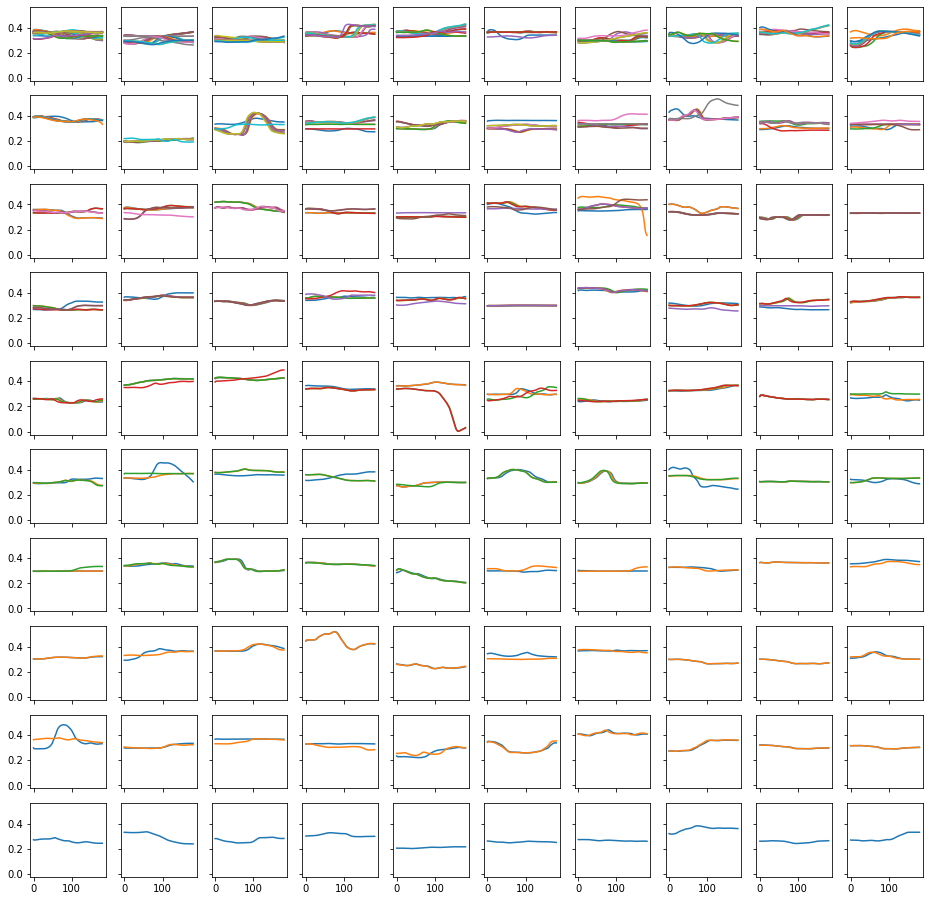

In [39]:
# Adrenalin
pharmaid = 1000655
idx_sub = list(set(idx_test).intersection(set(pharma_idx[pharmaid])))
idx_test_sub = []
for idx in idx_sub:
    idx_test_sub.append(idx_test.index(idx))
# idx_test_sub = np.array(idx_test)[idx_test_sub]

X_sub = X_pca[idx_test_sub]
data_sub = X_rec[idx_sub]

win_map = som.win_map(X_sub, return_indices=True)
win_map_sorted = sorted(win_map.items(), key=lambda item: len(item[1]), reverse=True)

fig, ax = plt.subplots(10,10,figsize=(16,16), sharey=True, sharex=True)
colors = plt.cm.tab20

for i in range(100):
    data_c = data_sub[win_map_sorted[i][1]]
    for j in range(data_c.shape[0]):
        ax[i//10][i%10].plot(range(181), data_c[j, :, 2])

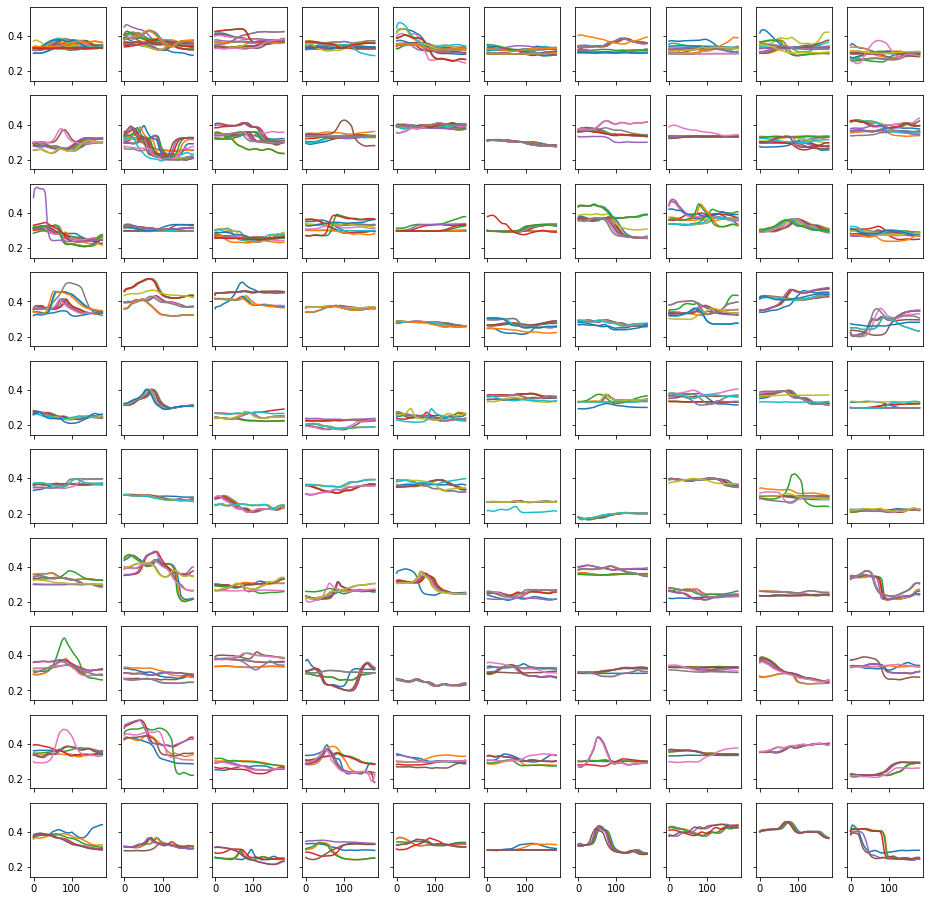

In [45]:
# Noradrenalin
pharmaid = 1000658
idx_sub = list(set(idx_test).intersection(set(pharma_idx[pharmaid])))
idx_test_sub = []
for idx in idx_sub:
    idx_test_sub.append(idx_test.index(idx))
# idx_test_sub = np.array(idx_test)[idx_test_sub]

X_sub = X_pca[idx_test_sub]
data_sub = X_rec[idx_sub]

win_map = som.win_map(X_sub, return_indices=True)
win_map_sorted = sorted(win_map.items(), key=lambda item: len(item[1]), reverse=True)

fig, ax = plt.subplots(10,10,figsize=(16,16), sharey=True, sharex=True)
colors = plt.cm.tab20

for i in range(100):
    data_c = data_sub[win_map_sorted[i][1]]
    for j in range(data_c.shape[0]):
        ax[i//10][i%10].plot(range(181), data_c[j, :, 2])

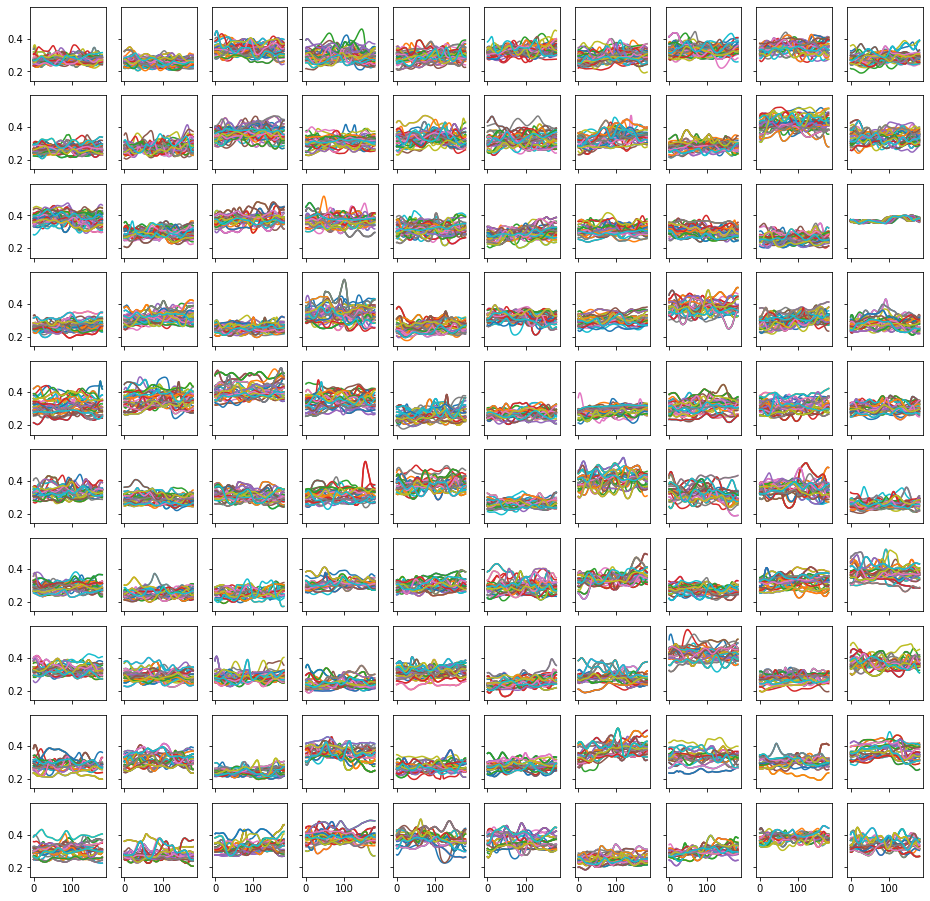

In [43]:
# Lasix
pharmaid = 1000747
idx_sub = list(set(idx_test).intersection(set(pharma_idx[pharmaid])))
idx_test_sub = []
for idx in idx_sub:
    tmp = idx_test.index(idx)
    if tmp >= len(idx_test):
        print(idx)
    idx_test_sub.append(tmp)
# idx_test_sub = np.array(idx_test)[idx_test_sub]

X_sub = X_pca[idx_test_sub]
data_sub = X_rec[idx_sub]

win_map = som.win_map(X_sub, return_indices=True)
win_map_sorted = sorted(win_map.items(), key=lambda item: len(item[1]), reverse=True)

fig, ax = plt.subplots(10,10,figsize=(16,16), sharey=True, sharex=True)
colors = plt.cm.tab20

for i in range(100):
    data_c = data_sub[win_map_sorted[i][1]]
#     for j in range(data_c.shape[0]):
    for j in np.random.choice(data_c.shape[0], 50):
        ax[i//10][i%10].plot(range(181), data_c[j, :, 3])

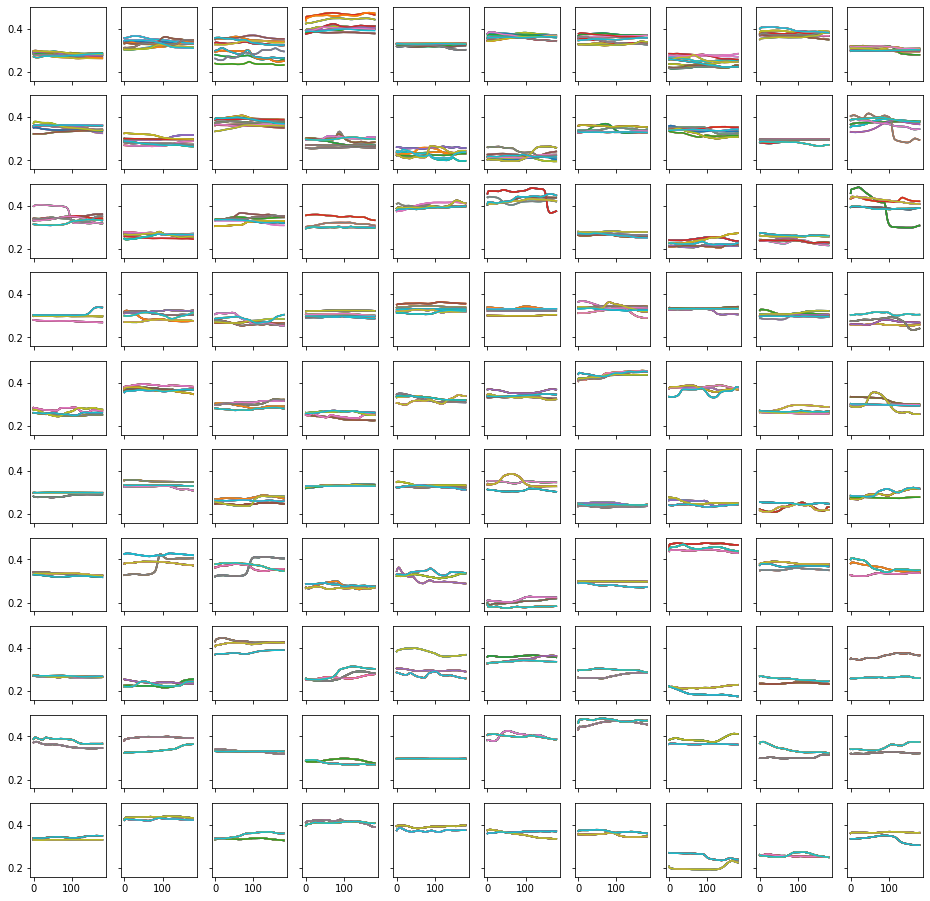

In [121]:
# Fentanyl
pharmaid = 251
idx_sub = list(set(idx_test).intersection(set(pharma_idx[pharmaid])))
idx_test_sub = []
for idx in idx_sub:
    tmp = idx_test.index(idx)
    if tmp >= len(idx_test):
        print(idx)
    idx_test_sub.append(tmp)
# idx_test_sub = np.array(idx_test)[idx_test_sub]

X_sub = X_pca[idx_test_sub]
data_sub = X_rec[idx_sub]

win_map = som.win_map(X_sub, return_indices=True)
win_map_sorted = sorted(win_map.items(), key=lambda item: len(item[1]), reverse=True)

fig, ax = plt.subplots(10,10,figsize=(16,16), sharey=True, sharex=True)
colors = plt.cm.tab20

for i in range(100):
    data_c = data_sub[win_map_sorted[i][1]]
#     for j in range(data_c.shape[0]):
    for j in np.random.choice(data_c.shape[0], 50):
        ax[i//10][i%10].plot(range(181), data_c[j, :, 2])

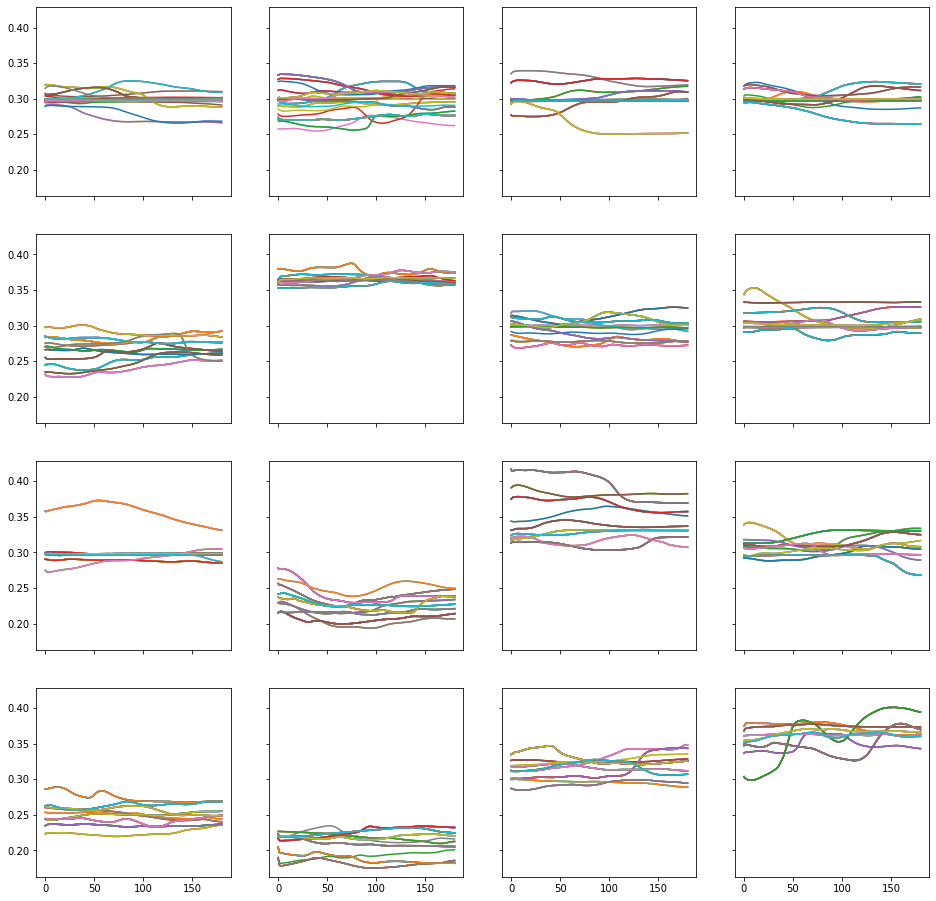

In [117]:
# Fentanyl
pharmaid = 1000657
idx_sub = list(set(idx_test).intersection(set(pharma_idx[pharmaid])))
idx_test_sub = []
for idx in idx_sub:
    tmp = idx_test.index(idx)
    if tmp >= len(idx_test):
        print(idx)
    idx_test_sub.append(tmp)
# idx_test_sub = np.array(idx_test)[idx_test_sub]

X_sub = X_pca[idx_test_sub]
data_sub = X_rec[idx_sub]

win_map = som.win_map(X_sub, return_indices=True)
win_map_sorted = sorted(win_map.items(), key=lambda item: len(item[1]), reverse=True)

fig, ax = plt.subplots(4,4,figsize=(16,16), sharey=True, sharex=True)
colors = plt.cm.tab20

for i in range(16):
    data_c = data_sub[win_map_sorted[i][1]]
#     for j in range(data_c.shape[0]):
    for j in np.random.choice(data_c.shape[0], 50):
        ax[i//4][i%4].plot(range(181), data_c[j, :, 2])

In [74]:
np.random.choice(data_c.shape[1], 10)

array([157, 150, 169,  62, 108, 156, 108,  32, 164,  80])

In [66]:
tmp

6283

In [60]:
np.array(idx_test)[idx_test_sub][:10]

IndexError: index 32772 is out of bounds for axis 0 with size 20183

In [61]:
32772 in idx_test_sub

True